In [166]:
### Import modules

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython.display import display
import glob
import lanefind
%matplotlib inline

import importlib
importlib.reload(lanefind)



<module 'lanefind' from '/Users/amorten/Projects/Udacity/SelfDrivingCar/Term1/CarND-Advanced-Lane-Lines/lanefind.py'>

In [167]:
### Define a helper function that plots on array of images
### in a nx by ny grid

def plot_images(images,nx,ny,figsize=(15,10),titles=[],fontsize=36,cmap=None):

    fig = plt.figure(figsize=figsize)

    for idx in range(len(images)):
    
        plt.subplot(nx,ny,idx+1)
        plt.imshow(images[idx],cmap=cmap)
        if(len(titles) > idx):
            plt.title(titles[idx],fontsize=fontsize)
    
    display(fig)
    plt.close()
        

Calibration images with detected corners:


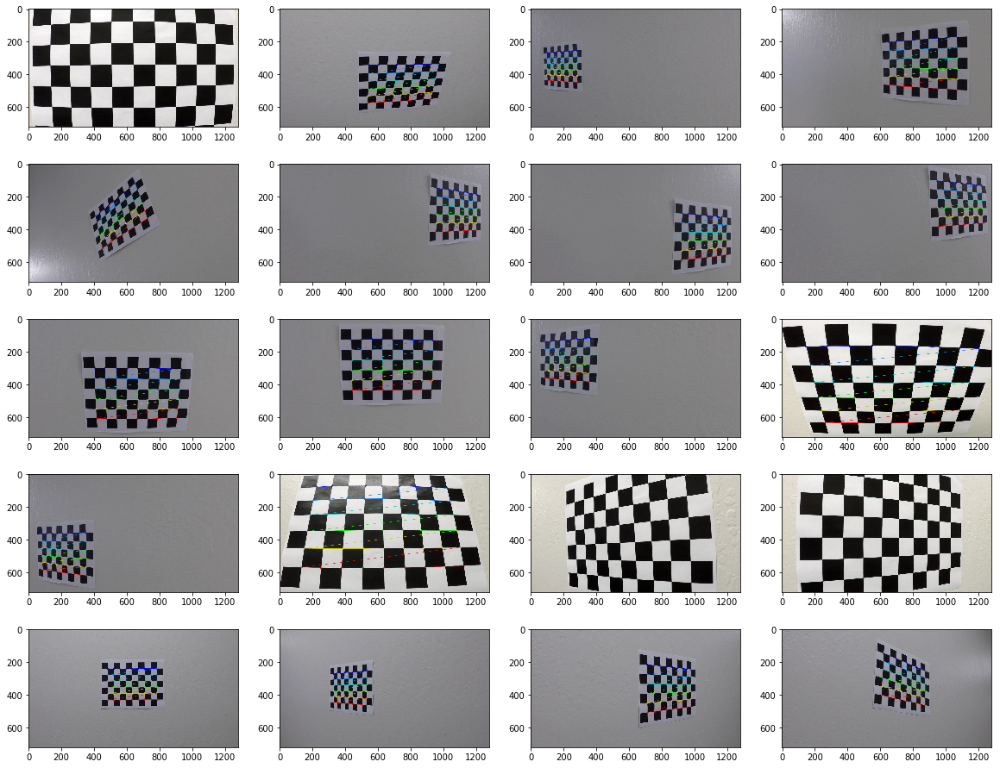

Undistorted Calibration images:


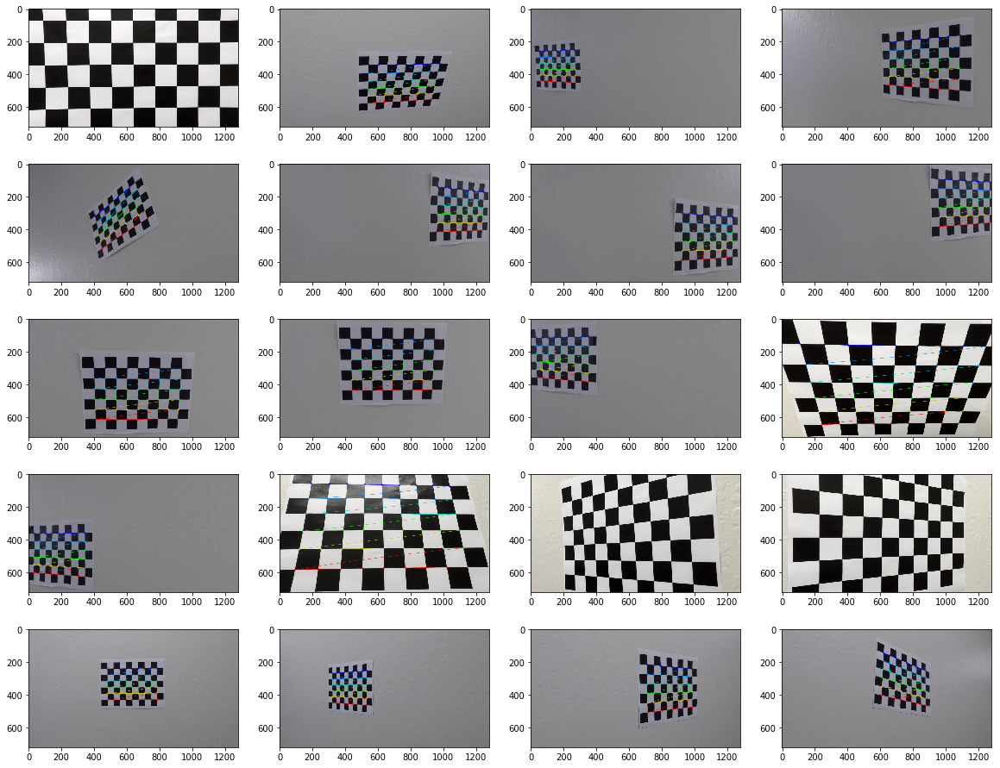

An example of undistorting a calibrtion image:


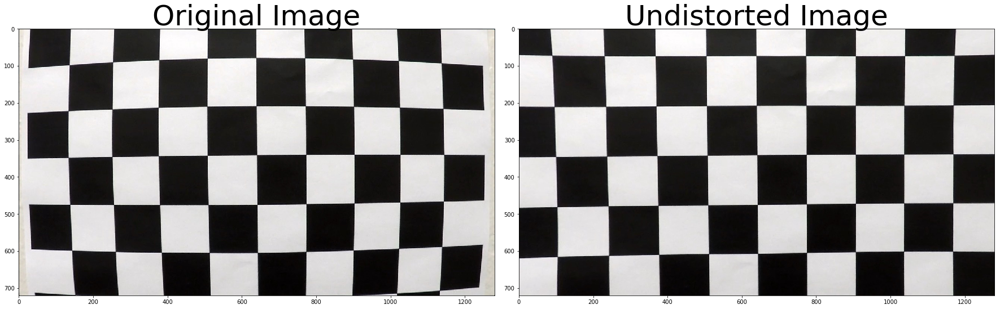

In [168]:
### Do the camera calibration

# prepare object points
nx = 9 # Number of inside corners in x
ny = 6 # Number of inside corners in y

# Make a list of calibration images
fnames = 'camera_cal/calibration*.jpg'
image_fnames = glob.glob(fnames)

# Calibrate camera using above list of calibration images
ret, mtx, dist, rvecs, tvecs, cal_images = lanefind.calibrate_camera(image_fnames,nx,ny)

# Plot the calibration images with corners drawn on
print("Calibration images with detected corners:")
plot_images(cal_images,5,4,figsize=(20,16))

# Plot all of the undistorted calibration images
cal_undists = []
for img in cal_images:

    cal_undist = cv2.undistort(img, mtx, dist, None, mtx)
    cal_undists.append(cal_undist)

print("Undistorted Calibration images:")
plot_images(cal_undists,5,4,figsize=(20,16))
    
# Plot an example undistorted image:
print("An example of undistorting a calibrtion image:")
img = mpimg.imread(image_fnames[0])
undist = cv2.undistort(img, mtx, dist, None, mtx)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


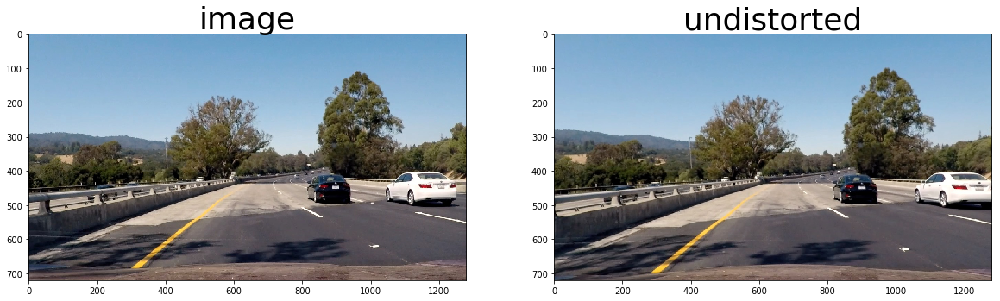

In [169]:
### For reference, here is how to apply a distortion correction 
### to a single image:

fname = 'test_images/test4.jpg'
image = mpimg.imread(fname)

undist = cv2.undistort(image, mtx, dist, None, mtx)

plot_images([image, undist],1,2,figsize=(20,8),titles=["image","undistorted"])


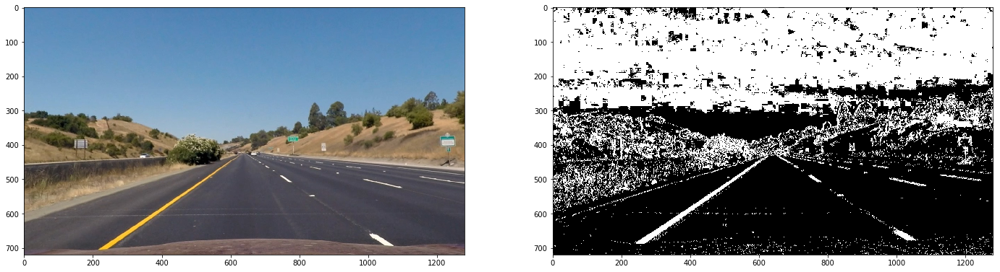

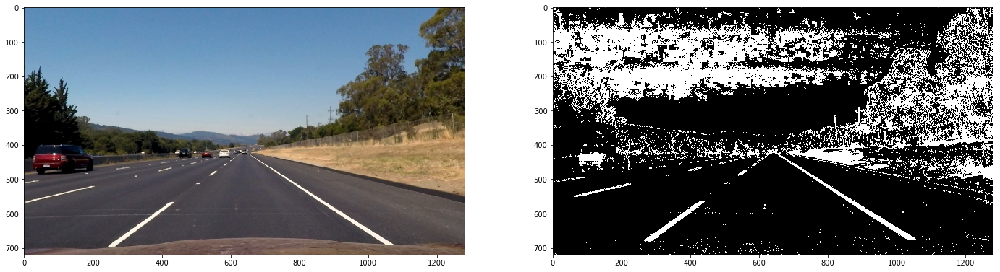

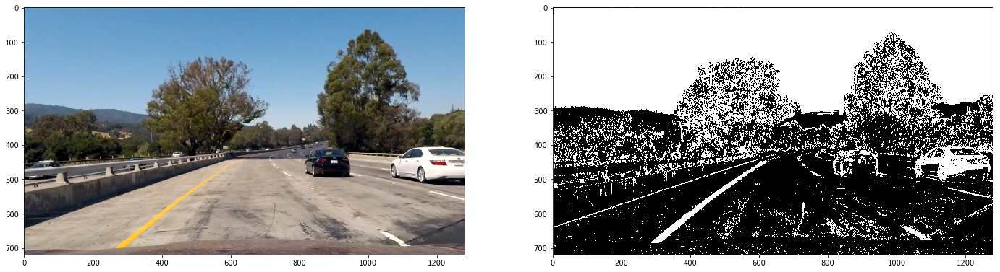

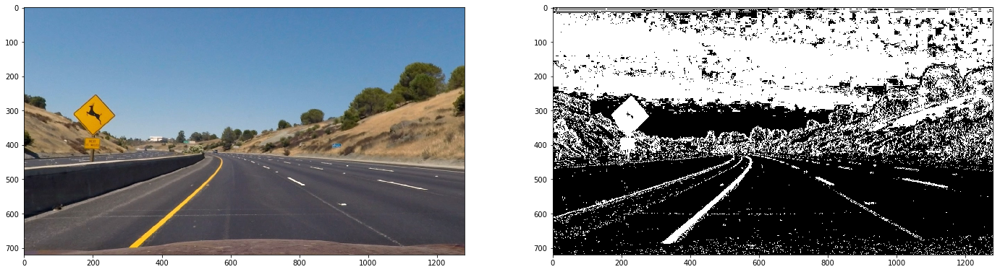

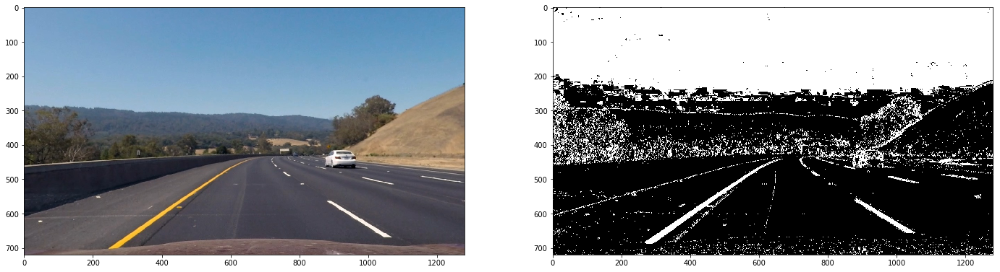

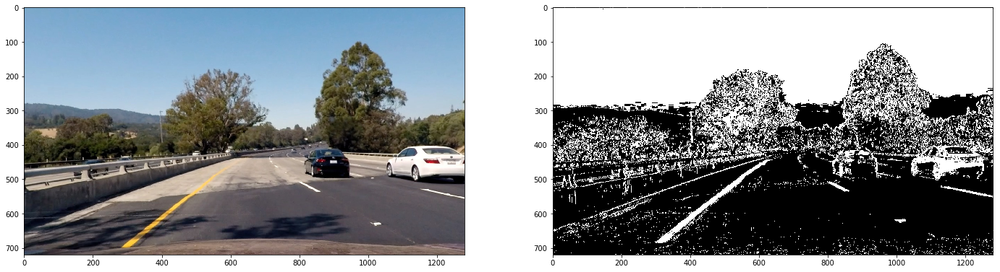

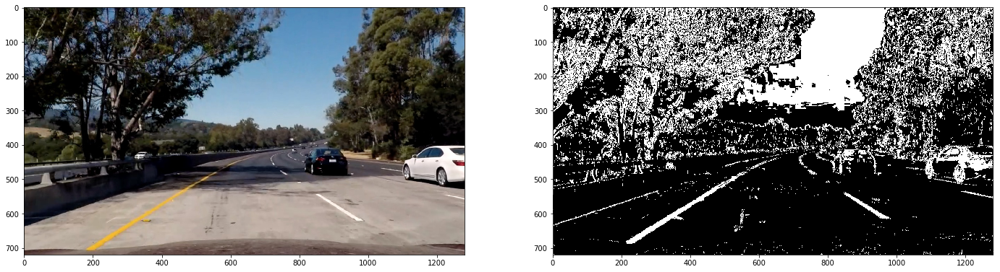

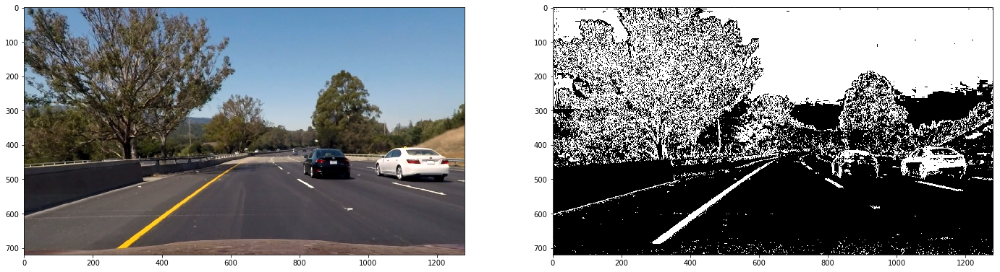

In [170]:
### Find lane pixels in all of the test images.
### And plot the resulting binary images.

fnames = 'test_images/*.jpg'
#fnames = 'test_images/test1.jpg'
image_fnames = glob.glob(fnames)

images = []
undists = []
color_binaries = []
combined_binaries = []

for fname in image_fnames:

    # First undistort the raw images
    img = mpimg.imread(fname)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # Then apply color/gradient thresholds to find lane lines
    color_binary, combined_binary = lanefind.threshold_image_improved(img, 
                                                             sx_thresh=(12,255), 
                                                             sy_thresh=(5,255), 
                                                             s_thresh=(100,255), 
                                                             v_thresh=(50,255))
    images.append(img)
    undists.append(undist)
    color_binaries.append(color_binary)
    combined_binaries.append(combined_binary)


# Plot both the undistorted image and binary lane pixes for each test image
for idx in range(len(images)):
    
    plot_images([undists[idx], combined_binaries[idx]],1,2,figsize=(24,9),cmap = "gray")


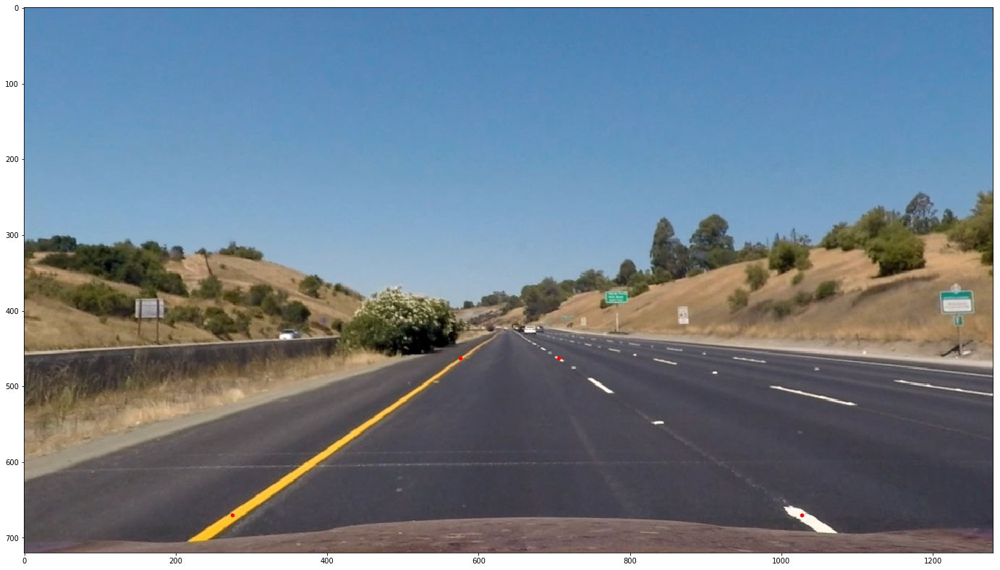

In [173]:
### Determine a trapezoid on the undistorted image 
### that would correspond to a rectangle when viewed
### from above (birds-eye view), and then compute
### the transformation matrix, M, and its inverse, Minv.
### Use an image with straight lane lines and indicate the
### corners of the trapezoid with red dots.

# this image has straight lane lines
image = undists[0]

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(24, 18))

ax.imshow(image)

# Here are the positions of the trapezoid corners, based
# on investigating the image manually

lr = [995+32,750-80] #[x,y] coords of lower right corner
ll = [243+32,750-80] #[x,y] coords of lower left corner
ur = [674+32,543-80] #[x,y] coords of upper right corner
ul = [544+32,543-80] #[x,y] coords of upper left corner

# Set margins so that that left curving and right curving
# lanes will be fully visible in birds-eye-view
margin_bottom = 40
margin_top = -200
margin_left = 70
margin_right = -70

src = np.float32([ur,lr,ll,ul])
dst = np.float32([[lr[0]+margin_right,ur[1]+margin_top],
                  [lr[0]+margin_right,lr[1]+margin_bottom],
                  [ll[0]+margin_left,ll[1]+margin_bottom],
                  [ll[0]+margin_left,ul[1]+margin_top]])

# Compute the perspective transform, M, given source and 
# destination points:
M = cv2.getPerspectiveTransform(src, dst)

# Compute the inverse perspective transform, Minv:
Minv = cv2.getPerspectiveTransform(dst, src)

# Now plot the corners of the trapezoid
ax.scatter(lr[0],lr[1],c='r',s=20)
ax.scatter(ll[0],ll[1],c='r',s=20)
ax.scatter(ur[0],ur[1],c='r',s=20)
ax.scatter(ul[0],ul[1],c='r',s=20)

plt.show()

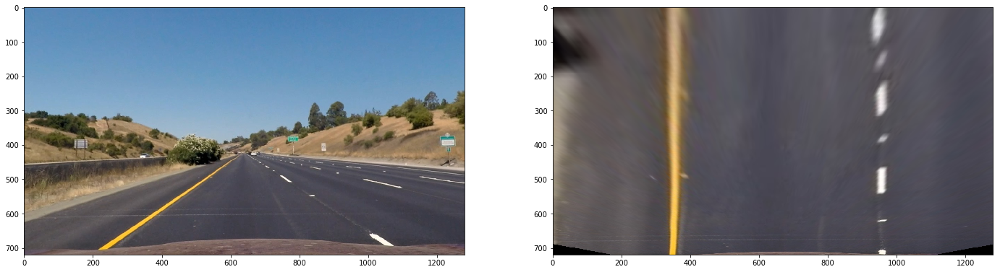

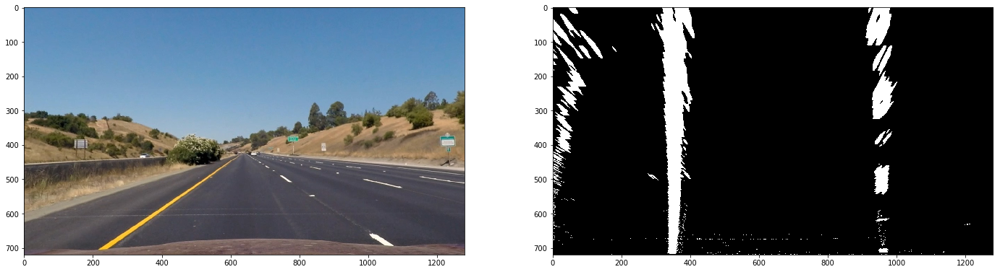

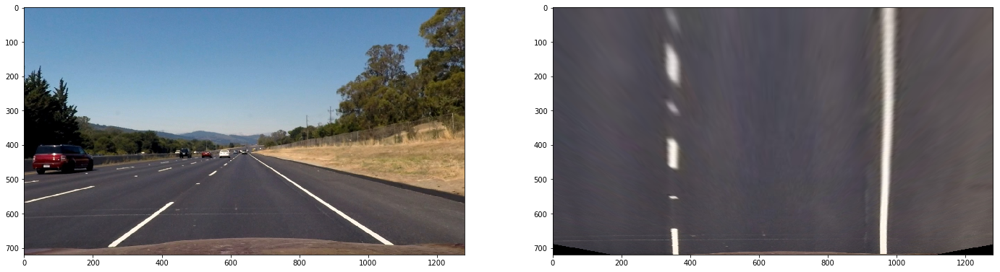

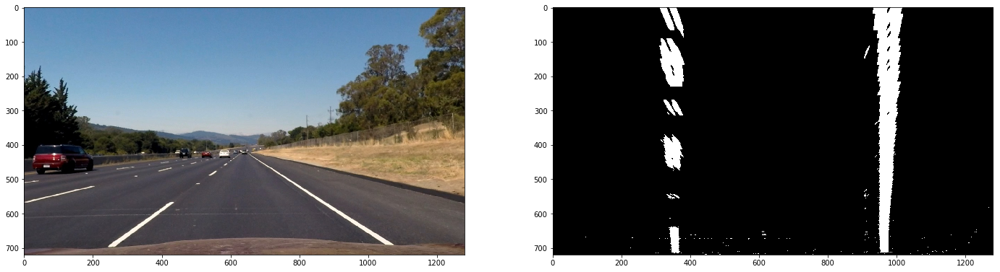

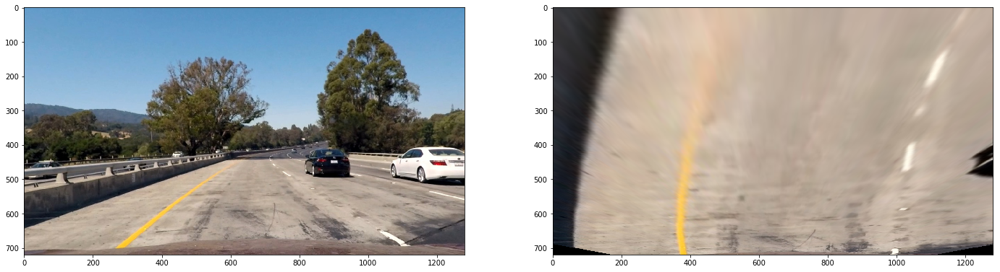

...

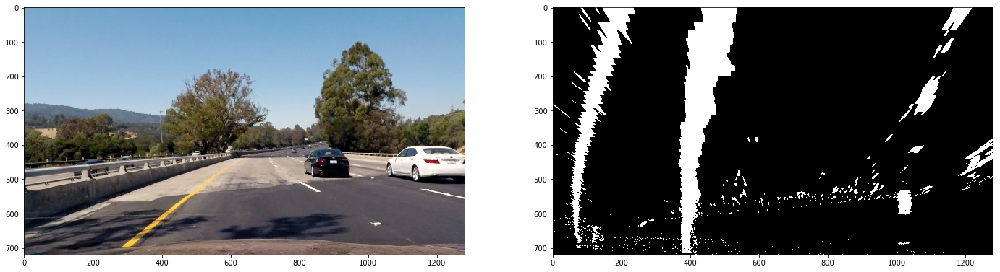

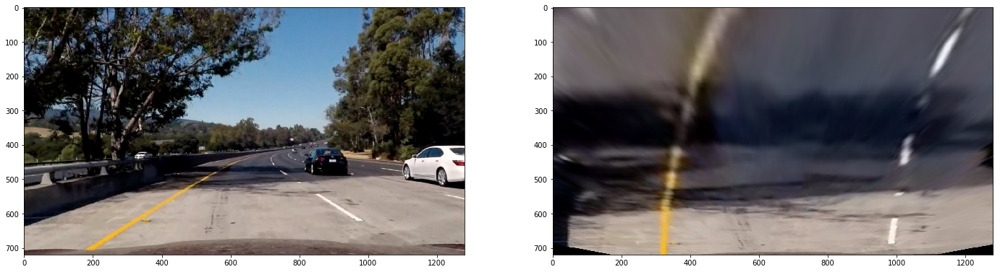

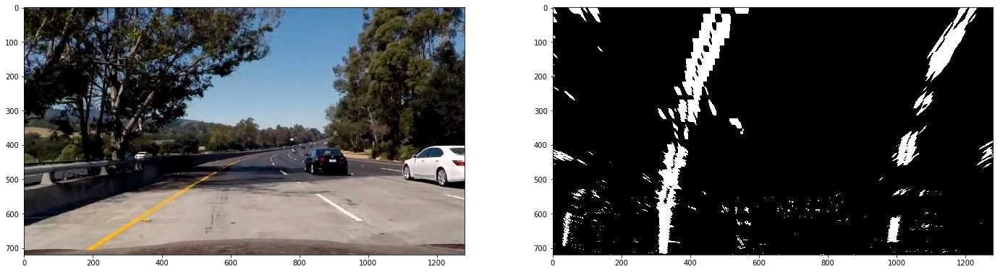

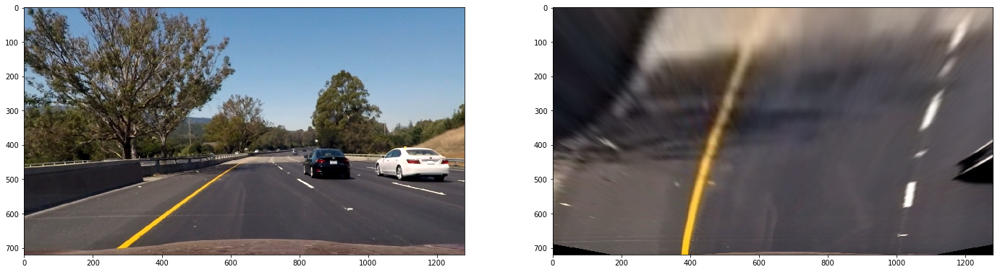

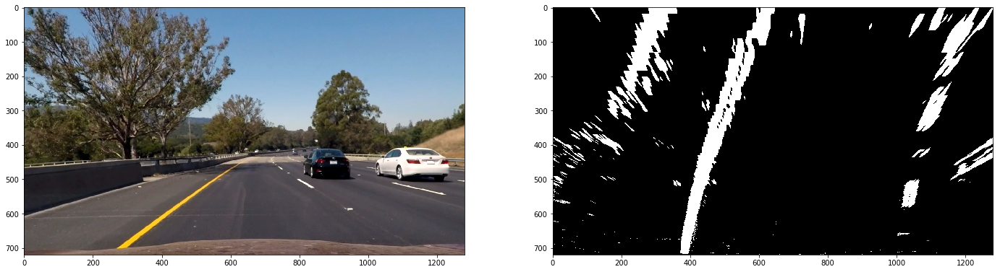

In [174]:
### Apply a perspective transform to rectify binary 
### image ("birds-eye view") for all test images.

warpeds = []
warped_color_binaries = []
warped_binaries = []
for idx in range(len(undists)):
    
    img = undists[idx]
    img_size = (img.shape[1], img.shape[0])
    
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    warpeds.append(warped)
    
    warped_color_binary = cv2.warpPerspective(color_binaries[idx], M, img_size, flags=cv2.INTER_LINEAR)
    warped_color_binaries.append(warped_color_binary)
    
    warped_binary = cv2.warpPerspective(combined_binaries[idx], M, img_size, flags=cv2.INTER_LINEAR)
    warped_binaries.append(warped_binary)
    
    # Plot the warped images and warped binaries
    plot_images([undists[idx], warpeds[idx]],1,2,figsize=(24,9))
    plot_images([undists[idx], warped_binaries[idx]],1,2,figsize=(24,9),cmap="gray")
    

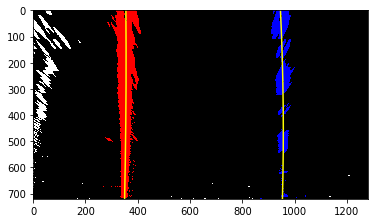

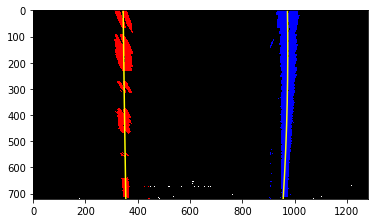

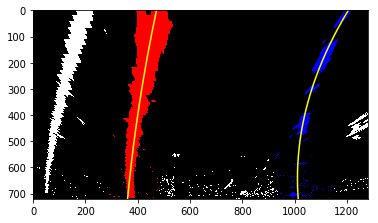

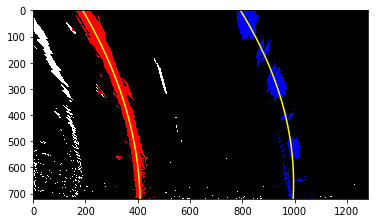

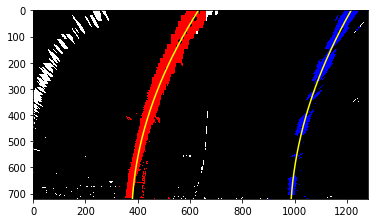

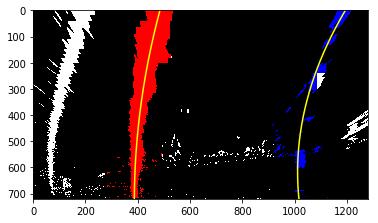

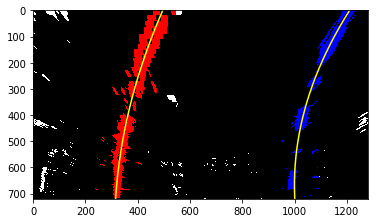

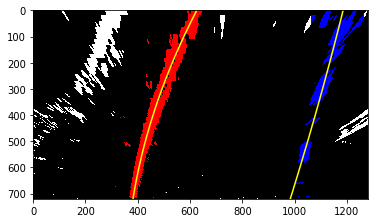

In [175]:
### Find lane lanes for all test images using the histogram method

import importlib
importlib.reload(lanefind)

out_imgs = []
lanes = []
for binary_warped in warped_binaries:
    lane, out_img = lanefind.find_lanes_by_histogram(
        binary_warped,initial_bottom_frac=0.5,nwindows=9)
    out_imgs.append(out_img)
    lanes.append(lane)

    plt.figure()
    plt.imshow(out_img)
    plt.plot(lane.left_fitx, lane.ploty, color='yellow')
    plt.plot(lane.right_fitx, lane.ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

#plot_images(out_imgs,4,2,figsize=(20,32))

In [176]:
### Calculate lane features for all of the test images.

img_shape = (1280,720)

for lane in lanes:
    lane = lanefind.calc_lane_features(lane,img_shape)

    print('Offset: ',lane.lane_offset,'m',
          '\nLeft lane pos: ',left_pos_x,'m',
          '\nRight lane pos: ',right_pos_x,'m')
    print('Left curvature: ',lane.left_curverad, 'm', 
          '\nRight curvature: ',lane.right_curverad, 'm\n')


Offset:  0.0614971883396 m 
Left lane pos:  1.84972801442 m 
Right lane pos:  5.03898064798 m
Left curvature:  7988.12402527 m 
Right curvature:  3209.48213011 m

Offset:  0.0814625676939 m 
Left lane pos:  1.84972801442 m 
Right lane pos:  5.03898064798 m
Left curvature:  45286.4407072 m 
Right curvature:  3025.1241473 m

Offset:  0.251107705713 m 
Left lane pos:  1.84972801442 m 
Right lane pos:  5.03898064798 m
Left curvature:  2024.40183657 m 
Right curvature:  348.892009401 m

Offset:  0.325741496047 m 
Left lane pos:  1.84972801442 m 
Right lane pos:  5.03898064798 m
Left curvature:  417.156454163 m 
Right curvature:  351.897363143 m

Offset:  0.229308809459 m 
Left lane pos:  1.84972801442 m 
Right lane pos:  5.03898064798 m
Left curvature:  416.976323717 m 
Right curvature:  475.715071084 m

Offset:  0.325741515418 m 
Left lane pos:  1.84972801442 m 
Right lane pos:  5.03898064798 m
Left curvature:  905.796386146 m 
Right curvature:  343.928292443 m

Offset:  0.0953231484162 m 

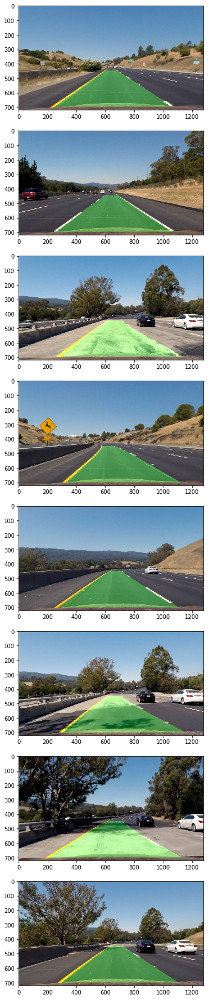

In [177]:
# Warp the detected lane boundaries back onto the original image.
# Output visual display of the lanes.

results = []
for idx in range(len(lanes)):

    lane = lanes[idx]
    undist = undists[idx]

    result = lanefind.draw_lane_lines(undist,Minv,lane,
                                          averaged_lanes=False)
    results.append(result)

plot_images(results,len(lanes),1,figsize=(8,32),titles=[])



In [178]:
### Import everything needed to edit/save/watch video clips

from moviepy.editor import VideoFileClip
from IPython.display import HTML


In [179]:
### Define the function process_image, which basically
### does all of the above steps (except camera calibration)

import importlib
importlib.reload(lanefind)

def process_image(image):
    
    # Global variable contains previous lane information
    global recent_lanes
    # Global variable the defines how many previous lanes
    # to be kept in recent_lanes.
    global n_history
    
    # Undist the input image
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    
    # Find lane lane pixels using grayscale gradient and color channel thresholds
    # The commented out method doesn't work as well as the "improved" method
    
    #color_binary, combined_binary = threshold_image(undist, s_thresh=(100, 255), sx_thresh=(20, 100), r_thresh=(220,255))
    color_binary, combined_binary = threshold_image_improved(undist, 
                                                             sx_thresh=(12,255), 
                                                             sy_thresh=(5,255), 
                                                             s_thresh=(100,255), 
                                                             v_thresh=(50,255))

    # Warp the binary image to birds-eye-view
    warped_binary = cv2.warpPerspective(combined_binary, M, img_size, flags=cv2.INTER_LINEAR)

    # Check whether previous lane lines have been detected
    if (len(recent_lanes)==0):
        no_prev_lane = True
        prev_lane = None
    else:
        no_prev_lane = False
        prev_lane = recent_lanes[0]

    if ( not no_prev_lane 
        and prev_lane.left_detected 
        and prev_lane.right_detected ):
        
        # If previous lane lines were valid, find new lanes based on previous
        lane, out_img = lanefind.find_lane_lanes_given_previous(warped_binary,prev_lane)
        
    else:
        # Otherwise, use the historgram method to detect lane lines from scratch
        print("No previous lane detected.")
        lane, out_img = lanefind.find_lanes_by_histogram(
            warped_binary,initial_bottom_frac=0.5,nwindows=9)
    
    # Calculate lane features 
    img_shape = warped_binary.shape[::-1]
    lane = lanefind.calc_lane_features(lane,img_shape)
    
    # Check whether the lane features are valid (on there own and
    # in comparison with previous lane values)
    lanefind.check_lane_validity(lane,prev_lane,
                        left_curverad_range=[100,1000000000],right_curverad_range=[100,1000000000],
                        left_pos_x_range=[1.5,2.5],right_pos_x_range=[4.8,5.8],
                        lane_width_range=[2.8,3.8],
                        left_curverad_max_ratio=10.,right_curverad_max_ratio=10.,
                        left_pos_x_max_diff=0.5,right_pos_x_max_diff=0.5,
                        lane_width_max_diff=0.5)

    # If lane history gets too large, remove the oldest element
    recent_lanes.insert(0,lane)
    if (len(recent_lanes) > n_history):
        recent_lanes.pop()
    
    # Average lane parameters over the history
    lanefind.calc_best_lane(recent_lanes)
        
    # Draw averaged lane on the undistorted original image
    lane = recent_lanes[0]
    result = lanefind.draw_lane_lines(undist,Minv,lane,
                                      averaged_lanes=True)
    
    # Uncomment the following lines to plot both averaged 
    # and raw lane lines. It's much slower to plot for
    # every frame in the video, but very useful for debugging.
    
    #result_no_ave = lanefind.draw_lane_lines(undist,Minv,lane,
    #                                         averaged_lanes=False)
    #plot_images([result,result_no_ave],1,2,figsize=(20,6),titles=["ave","raw"])
    
    
    return result


No previous lane detected.
Curve:  15162.0175501 m, 3086.65270322 m
Pos:  1.85278356585 m, 5.02530754747 m
Width:  3.17252398162 m
Offset:  0.056188413807 m
Current lanes are valid.


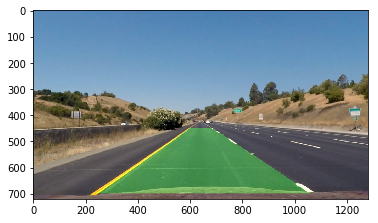

No previous lane detected.
Curve:  73035.2754124 m, 2318.09396827 m
Pos:  1.8762948945 m, 5.03953858243 m
Width:  3.16324368793 m
Offset:  0.0750595956044 m
Current lanes are valid.


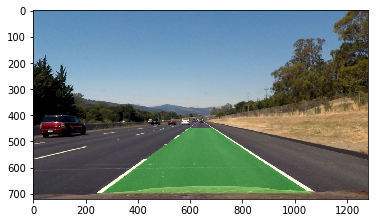

No previous lane detected.
Curve:  2404.37767554 m, 374.577754046 m
Pos:  1.90984913964 m, 5.30940759485 m
Width:  3.39955845522 m
Offset:  0.226771224388 m
Current lanes are valid.


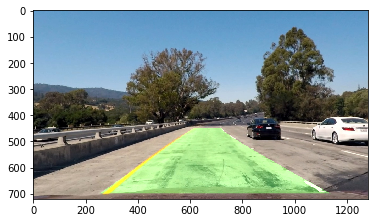

No previous lane detected.
Curve:  435.021520597 m, 363.201616803 m
Pos:  2.16807097825 m, 5.2454062628 m
Width:  3.07733528455 m
Offset:  0.323881477671 m
Current lanes are valid.


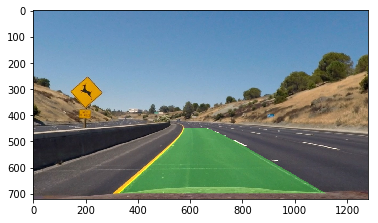

No previous lane detected.
Curve:  420.787489998 m, 495.365783843 m
Pos:  2.01366378032 m, 5.19652553945 m
Width:  3.18286175913 m
Offset:  0.22223751703 m
Current lanes are valid.


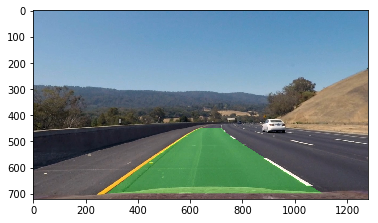

No previous lane detected.
Curve:  880.6588904 m, 345.805619373 m
Pos:  2.05434071047 m, 5.34992271297 m
Width:  3.2955820025 m
Offset:  0.319274568863 m
Current lanes are valid.


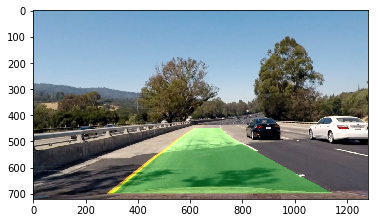

No previous lane detected.
Curve:  633.24815329 m, 352.248681079 m
Pos:  1.67676798885 m, 5.27435643282 m
Width:  3.59758844397 m
Offset:  0.0927050679811 m
Current lanes are valid.


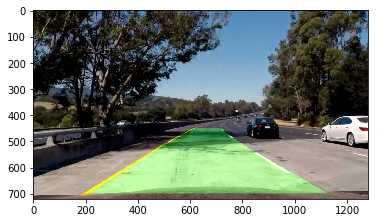

No previous lane detected.
Curve:  687.373958255 m, 4117.21547449 m
Pos:  2.0240692218 m, 5.18974471426 m
Width:  3.16567549246 m
Offset:  0.224049825169 m
Current lanes are valid.


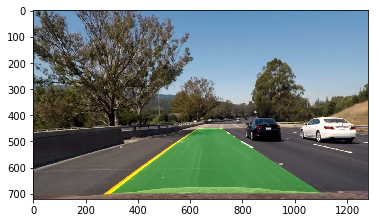

In [180]:
### Test the pipeline on the test images

fnames = 'test_images/*.jpg'
image_fnames = glob.glob(fnames)

for fname in image_fnames:

    img = mpimg.imread(fname)
    
    recent_lanes = []
    n_history = 5
    
    img = process_image(img)
    fig = plt.figure()
    plt.imshow(img)
    display(fig)
    plt.close()
    

In [182]:
video_name = 'project_video.mp4'
video_output_name = 'lane_lines.mp4'
recent_lanes = []
n_history = 3
# Define clip1 once by uncommenting one the following lines for 
# various subclips of interst.
#clip1 = VideoFileClip(video_name).subclip(40,42) #Shady area
#clip1 = VideoFileClip(video_name).subclip(9,13) # switch from curve to straight
clip1 = VideoFileClip(video_name) # The full video
clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time clip.write_videofile(video_output_name, audio=False)

No previous lane detected.
Curve:  3792.63443004 m, 377.433025276 m
Pos:  1.87588402675 m, 5.30982456754 m
Width:  3.43394054079 m
Offset:  0.209997154284 m
Current lanes are valid.
[MoviePy] >>>> Building video lane_lines.mp4
[MoviePy] Writing video lane_lines.mp4


  2%|▏         | 1/51 [00:00<00:12,  4.07it/s]

Curve:  3855.56557073 m, 570.826242988 m
Pos:  1.87460213649 m, 5.15397432744 m
Width:  3.27937219095 m
Offset:  0.131431089105 m
Current lanes are valid.


  4%|▍         | 2/51 [00:00<00:12,  4.06it/s]

Curve:  6428.67643007 m, 1077.28473427 m
Pos:  1.84372635777 m, 5.09003311179 m
Width:  3.24630675401 m
Offset:  0.0840225919237 m
Current lanes are valid.


  6%|▌         | 3/51 [00:00<00:11,  4.07it/s]

Curve:  3068.25435934 m, 1452.00993733 m
Pos:  1.83240716933 m, 5.07784796596 m
Width:  3.24544079663 m
Offset:  0.072270424786 m
Current lanes are valid.


  8%|▊         | 4/51 [00:01<00:11,  3.92it/s]

Curve:  2858.09396394 m, 1013.1678567 m
Pos:  1.81229953049 m, 5.14951835241 m
Width:  3.33721882191 m
Offset:  0.0980517985938 m
Current lanes are valid.


 10%|▉         | 5/51 [00:01<00:11,  3.96it/s]

Curve:  3666.1061012 m, 987.869842253 m
Pos:  1.77217772004 m, 5.20056465025 m
Width:  3.42838693021 m
Offset:  0.103514042291 m
Current lanes are valid.


 12%|█▏        | 6/51 [00:01<00:12,  3.55it/s]

Curve:  3665.04676149 m, 602.444494806 m
Pos:  1.86057823099 m, 5.22539697408 m
Width:  3.36481874309 m
Offset:  0.160130459675 m
Current lanes are valid.


 14%|█▎        | 7/51 [00:01<00:11,  3.78it/s]

Curve:  632.381326376 m, 662.550347485 m
Pos:  1.92630666033 m, 5.21667920655 m
Width:  3.29037254621 m
Offset:  0.188635790581 m
Current lanes are valid.


 16%|█▌        | 8/51 [00:02<00:11,  3.90it/s]

Curve:  1438.40620279 m, 425.527329708 m
Pos:  1.82174180485 m, 5.25361385326 m
Width:  3.43187204841 m
Offset:  0.154820686199 m
Current lanes are valid.


 18%|█▊        | 9/51 [00:02<00:10,  4.08it/s]

Curve:  1347.05700077 m, 394.11705899 m
Pos:  1.85934181143 m, 5.26598615811 m
Width:  3.40664434668 m
Offset:  0.179806841909 m
Current lanes are valid.


 20%|█▉        | 10/51 [00:02<00:10,  4.06it/s]

Curve:  1076.3732826 m, 391.115141091 m
Pos:  1.82399154209 m, 5.27379161061 m
Width:  3.44980006852 m
Offset:  0.166034433493 m
Current lanes are valid.


 22%|██▏       | 11/51 [00:02<00:09,  4.10it/s]

Curve:  920.879571234 m, 439.899383211 m
Pos:  1.84441489889 m, 5.2328163832 m
Width:  3.38840148431 m
Offset:  0.155758498189 m
Current lanes are valid.


 24%|██▎       | 12/51 [00:03<00:09,  4.07it/s]

Curve:  742.076109976 m, 453.578057759 m
Pos:  1.84090220495 m, 5.24376940371 m
Width:  3.40286719876 m
Offset:  0.159478661471 m
Current lanes are valid.


 25%|██▌       | 13/51 [00:03<00:09,  4.09it/s]

Curve:  837.822658617 m, 418.430235765 m
Pos:  1.81234749918 m, 5.24085877348 m
Width:  3.4285112743 m
Offset:  0.143745993476 m
Current lanes are valid.


 27%|██▋       | 14/51 [00:03<00:08,  4.12it/s]

Curve:  745.709528352 m, 428.870929073 m
Pos:  1.82394958724 m, 5.24483335368 m
Width:  3.42088376644 m
Offset:  0.151534327606 m
Current lanes are valid.


 29%|██▉       | 15/51 [00:03<00:08,  4.09it/s]

Curve:  693.748026662 m, 520.648520775 m
Pos:  1.81584713995 m, 5.20873826998 m
Width:  3.39289113003 m
Offset:  0.129435562105 m
Current lanes are valid.


 31%|███▏      | 16/51 [00:04<00:08,  4.07it/s]

Curve:  716.047996065 m, 466.12526681 m
Pos:  1.8098733034 m, 5.2199358687 m
Width:  3.4100625653 m
Offset:  0.132047443188 m
Current lanes are valid.
Curve: 

 33%|███▎      | 17/51 [00:04<00:07,  4.26it/s]

 916.777446769 m, 1451.69398833 m
Pos:  1.77987466016 m, 5.0984849081 m
Width:  3.31861024794 m
Offset:  0.0563226412751 m
Current lanes are valid.


 35%|███▌      | 18/51 [00:04<00:07,  4.31it/s]

Curve:  726.025108906 m, 1276.20847254 m
Pos:  1.78718174822 m, 5.10849432316 m
Width:  3.32131257494 m
Offset:  0.0649808928316 m
Current lanes are valid.


 37%|███▋      | 19/51 [00:04<00:07,  4.11it/s]

Curve:  576.196155023 m, 1006.32975393 m
Pos:  1.80232242499 m, 5.13989662421 m
Width:  3.33757419922 m
Offset:  0.0882523817424 m
Current lanes are valid.


 39%|███▉      | 20/51 [00:04<00:07,  4.06it/s]

Curve:  583.520894592 m, 1073.34569801 m
Pos:  1.79845744328 m, 5.16325913397 m
Width:  3.36480169069 m
Offset:  0.0980011457692 m
Current lanes are valid.


 41%|████      | 21/51 [00:05<00:07,  4.15it/s]

Curve:  397.810613769 m, 941.608111967 m
Pos:  1.84457846469 m, 5.17732926292 m
Width:  3.33275079823 m
Offset:  0.128096720951 m
Current lanes are valid.


 43%|████▎     | 22/51 [00:05<00:06,  4.17it/s]

Curve:  389.007299708 m, 979.064122568 m
Pos:  1.83236957112 m, 5.18776085454 m
Width:  3.35539128342 m
Offset:  0.127208069973 m
Current lanes are valid.


 45%|████▌     | 23/51 [00:05<00:06,  4.24it/s]

Curve:  406.825458218 m, 969.511559822 m
Pos:  1.80054124315 m, 5.19331939211 m
Width:  3.39277814896 m
Offset:  0.114073174772 m
Current lanes are valid.


 47%|████▋     | 24/51 [00:05<00:06,  4.17it/s]

Curve:  412.920436192 m, 893.277114778 m
Pos:  1.78578286 m, 5.21182871026 m
Width:  3.42604585025 m
Offset:  0.115948642274 m
Current lanes are valid.


 49%|████▉     | 25/51 [00:06<00:06,  4.25it/s]

Curve:  384.100062309 m, 846.762371539 m
Pos:  1.7731020648 m, 5.23247282564 m
Width:  3.45937076084 m
Offset:  0.119930302362 m
Current lanes are valid.


 51%|█████     | 26/51 [00:06<00:05,  4.27it/s]

Curve:  515.455171388 m, 850.835961823 m
Pos:  1.72611031072 m, 5.24034668599 m
Width:  3.51423637528 m
Offset:  0.100371355498 m
Current lanes are valid.


 53%|█████▎    | 27/51 [00:06<00:05,  4.23it/s]

Curve:  573.634519444 m, 388.220356609 m
Pos:  1.70598857279 m, 5.33987767261 m
Width:  3.63388909983 m
Offset:  0.140075979842 m
Current lanes are valid.


 55%|█████▍    | 28/51 [00:06<00:05,  3.95it/s]

Curve:  508.114371156 m, 383.527724635 m
Pos:  1.72771995171 m, 5.31163292394 m
Width:  3.58391297223 m
Offset:  0.136819294966 m
Current lanes are valid.


 57%|█████▋    | 29/51 [00:07<00:05,  3.79it/s]

Curve:  462.034569708 m, 315.713835878 m
Pos:  1.73994946661 m, 5.32801551098 m
Width:  3.58806604437 m
Offset:  0.151125345937 m
Current lanes are valid.


 59%|█████▉    | 30/51 [00:07<00:05,  3.63it/s]

Curve:  538.2988148 m, 284.477077457 m
Pos:  1.71569971029 m, 5.38046656163 m
Width:  3.66476685134 m
Offset:  0.165225993105 m
Current lanes are valid.


 61%|██████    | 31/51 [00:07<00:05,  3.60it/s]

Curve:  474.986047015 m, 296.211966925 m
Pos:  1.72262165837 m, 5.32617661085 m
Width:  3.60355495248 m
Offset:  0.141541991758 m
Current lanes are valid.


 63%|██████▎   | 32/51 [00:08<00:05,  3.66it/s]

Curve:  527.341409621 m, 298.081736087 m
Pos:  1.70665937029 m, 5.30870779274 m
Width:  3.60204842245 m
Offset:  0.124826438661 m
Current lanes are valid.


 65%|██████▍   | 33/51 [00:08<00:04,  3.69it/s]

Curve:  568.673669732 m, 353.917041045 m
Pos:  1.6893703827 m, 5.27324027564 m
Width:  3.58386989294 m
Offset:  0.0984481863086 m
Current lanes are valid.


 67%|██████▋   | 34/51 [00:08<00:04,  3.46it/s]

Curve:  435.246679316 m, 332.444498481 m
Pos:  1.71832920447 m, 5.25675338861 m
Width:  3.53842418414 m
Offset:  0.104684153686 m
Current lanes are valid.


 69%|██████▊   | 35/51 [00:08<00:04,  3.50it/s]

Curve:  372.696614951 m, 340.088293102 m
Pos:  1.74628582572 m, 5.23885595736 m
Width:  3.49257013164 m
Offset:  0.109713748684 m
Current lanes are valid.


 71%|███████   | 36/51 [00:09<00:03,  3.76it/s]

Curve:  357.463075714 m, 316.64839292 m
Pos:  1.75358935443 m, 5.24503378073 m
Width:  3.4914444263 m
Offset:  0.116454424723 m
Current lanes are valid.


 73%|███████▎  | 37/51 [00:09<00:03,  3.78it/s]

Curve:  347.626169159 m, 321.826314615 m
Pos:  1.75669933659 m, 5.21986748646 m
Width:  3.46316814986 m
Offset:  0.105426268669 m
Current lanes are valid.


 75%|███████▍  | 38/51 [00:09<00:03,  3.83it/s]

Curve:  355.131818205 m, 328.964546329 m
Pos:  1.75890215437 m, 5.22609830266 m
Width:  3.46719614829 m
Offset:  0.10964308566 m
Current lanes are valid.


 76%|███████▋  | 39/51 [00:09<00:03,  3.78it/s]

Curve:  363.18582736 m, 329.375326919 m
Pos:  1.75547103758 m, 5.19732428876 m
Width:  3.44185325118 m
Offset:  0.0935405203106 m
Current lanes are valid.


 78%|███████▊  | 40/51 [00:10<00:02,  3.92it/s]

Curve:  368.524099231 m, 379.658936853 m
Pos:  1.7655517758 m, 5.16796788539 m
Width:  3.40241610959 m
Offset:  0.0839026877362 m
Current lanes are valid.


 80%|████████  | 41/51 [00:10<00:02,  3.94it/s]

Curve:  361.926852165 m, 470.502475948 m
Pos:  1.76361954636 m, 5.13302804455 m
Width:  3.36940849819 m
Offset:  0.0654666526007 m
Current lanes are valid.


 82%|████████▏ | 42/51 [00:10<00:02,  4.03it/s]

Curve:  373.643702793 m, 468.141516353 m
Pos:  1.74832142873 m, 5.08346273043 m
Width:  3.3351413017 m
Offset:  0.0330349367244 m
Current lanes are valid.


 84%|████████▍ | 43/51 [00:10<00:02,  3.82it/s]

Curve:  394.616219642 m, 532.093896338 m
Pos:  1.73389455777 m, 5.07398800299 m
Width:  3.34009344522 m
Offset:  0.0210841375192 m
Current lanes are valid.


 86%|████████▋ | 44/51 [00:11<00:01,  3.89it/s]

Curve:  401.236159053 m, 519.11521961 m
Pos:  1.72808099123 m, 5.08461076326 m
Width:  3.35652977204 m
Offset:  0.0234887343879 m
Current lanes are valid.


 88%|████████▊ | 45/51 [00:11<00:01,  3.92it/s]

Curve:  461.698555382 m, 583.60821352 m
Pos:  1.71632360758 m, 5.12370048989 m
Width:  3.40737688232 m
Offset:  0.0371549058764 m
Current lanes are valid.


 90%|█████████ | 46/51 [00:11<00:01,  3.65it/s]

Curve:  501.797143103 m, 608.943371424 m
Pos:  1.67619326235 m, 5.07128327703 m
Width:  3.39509001468 m
Offset:  -0.00911887316792 m
Current lanes are valid.


 92%|█████████▏| 47/51 [00:12<00:01,  3.40it/s]

Curve:  569.08388166 m, 907.493930413 m
Pos:  1.6668050083 m, 5.04292360134 m
Width:  3.37611859304 m
Offset:  -0.0279928380382 m
Current lanes are valid.


 94%|█████████▍| 48/51 [00:12<00:00,  3.50it/s]

Curve:  607.836090167 m, 726.385222379 m
Pos:  1.63534816018 m, 5.07804481665 m
Width:  3.44269665647 m
Offset:  -0.0261606544448 m
Current lanes are valid.


 96%|█████████▌| 49/51 [00:12<00:00,  3.25it/s]

Curve:  664.972556541 m, 674.009659983 m
Pos:  1.61260700198 m, 5.10719986987 m
Width:  3.49459286789 m
Offset:  -0.0229537069347 m
Current lanes are valid.


 98%|█████████▊| 50/51 [00:12<00:00,  3.34it/s]

Curve:  806.457139966 m, 865.59782296 m
Pos:  1.59705767976 m, 5.10056789773 m
Width:  3.50351021797 m
Offset:  -0.0340443541081 m
Current lanes are valid.


[MoviePy] Done.
[MoviePy] >>>> Video ready: lane_lines.mp4 

CPU times: user 11.1 s, sys: 3.98 s, total: 15.1 s
Wall time: 15.6 s
